[0.0036414282, 0.004477879, 0.004911485, 0.004977305, 0.005170917]
[0.0037647455, 0.0042297454, 0.00416403, 0.003978262, 0.005229232]
correlation couleur rouge 1 0.008982898845515919
correlation couleur rouge 2 0.007806188872501497
correlation couleur carton 1 0.005688790722466139
correlation couleur carton 2 0.0047483176157603274
correlation couleur  0.0047483176157603274


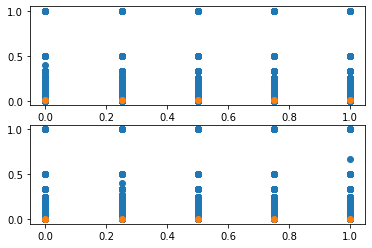

In [2]:
import utils
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
df_cc = utils.load_csv('data.csv', ['playerShort', 'games', 'yellowReds', 'redCards', 'rater1', 'rater2', 'position'])
df_cc.drop(df_cc[df_cc['games']==0].index)
data_ar = df_cc.to_numpy()
mask1 =~np.isnan(data_ar[:, 5].astype(np.float32))
mask2 =~np.isnan(data_ar[:, 4].astype(np.float32))
data_ar = data_ar[mask1*mask2]
col_1 = data_ar[:, 4].astype(np.float32)
col_2 = data_ar[:, 5].astype(np.float32)
col_moy = (col_1+col_2)/2
cart_par_match = np.divide(data_ar[:, 2].astype(np.float32), data_ar[:, 1].astype(np.float32))
red_par_match = np.divide(data_ar[:, 3].astype(np.float32), data_ar[:, 1].astype(np.float32))
means_red = [np.mean(red_par_match[col_1==x]) for x in np.linspace(0, 1, 5)]
print(means_red)
means_cart = [np.mean(cart_par_match[col_1==x]) for x in np.linspace(0, 1, 5)]
print(means_cart)

print(f'correlation couleur rouge 1 {utils.coeff_correl((col_1+col_2)/2, red_par_match)[0,1]}')
print(f'correlation couleur rouge 2 {utils.coeff_correl(col_2, red_par_match)[0,1]}')
print(f'correlation couleur carton 1 {utils.coeff_correl(col_1, cart_par_match)[0,1]}')
print(f'correlation couleur carton 2 {utils.coeff_correl(col_2, cart_par_match)[0,1]}')
print(f'correlation couleur  {utils.coeff_correl(col_2, cart_par_match)[0,1]}')
fig, ax = plt.subplots(2, 1)
ax[0].scatter(col_1, cart_par_match)
ax[0].scatter(np.linspace(0, 1, 5), means_cart)
ax[1].scatter(col_1, red_par_match)
ax[1].scatter(np.linspace(0, 1, 5), means_red)

Text(0.5, 1.0, 'couleur en fonction du poste')

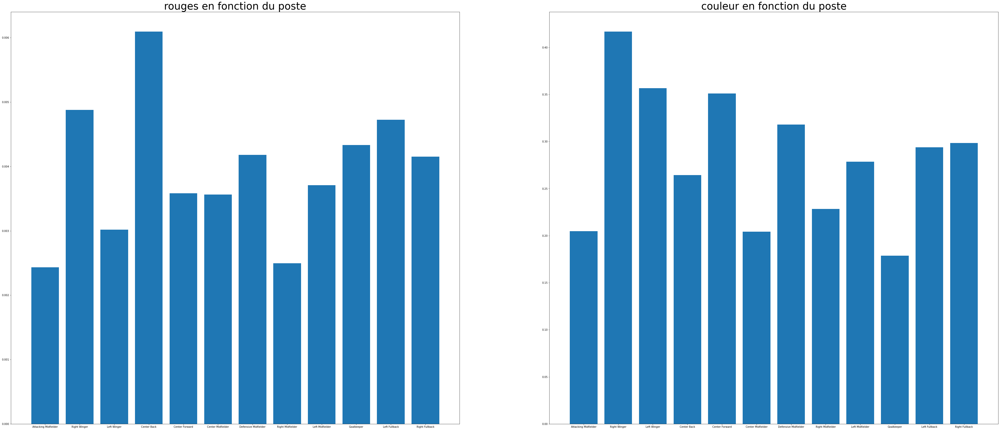

In [4]:
fig, ax = plt.subplots(1, 2, figsize = (70, 30))
x = ['Attacking Midfielder', 'Right Winger', 'Left Winger', 'Center Back', 'Center Forward', 'Center Midfielder', 'Defensive Midfielder', 'Right Midfielder', 'Left Midfielder', 'Goalkeeper', 'Left Fullback', 'Right Fullback']
ax[0].bar(x, [np.mean(red_par_match[data_ar[:, -1]==a]) for a in x])
ax[0].set_title('rouges en fonction du poste', fontsize = 40)
ax[1].bar(x, [np.mean(col_moy[data_ar[:, -1]==a]) for a in x])
ax[1].set_title('couleur en fonction du poste', fontsize = 40)

[0.0054839626, 0.003974168, 0.004495273, 0.0, 0.0046009836, 0.021759259, 0.0034700315, 0.0, 0.0069156853]


Text(0.5, 1.0, 'Rouges en fonction de la couleur pour ailier droit')

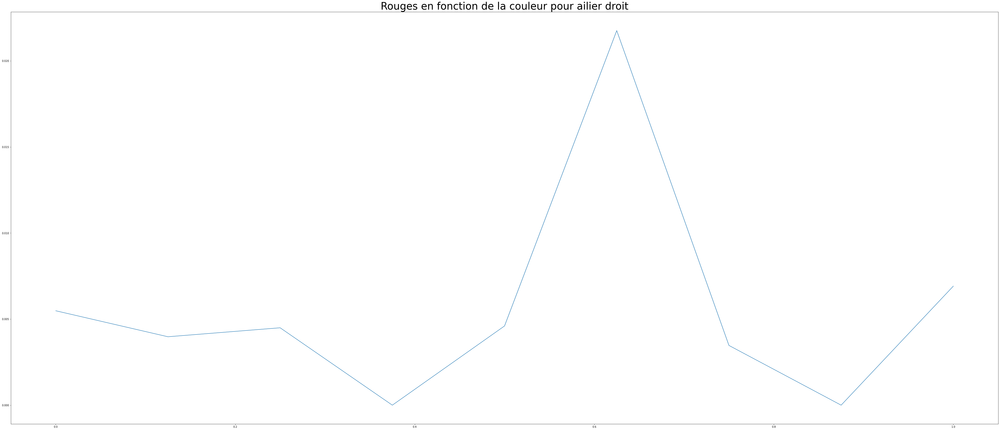

In [18]:
#On se concentre sur les right wingers. Ils ont un nombre de rouges étonnant.
fig, ax = plt.subplots(figsize = (70, 30))
val_col_moy = np.sort(list(set(col_moy)))
means_right_winger_per_color = [np.mean(red_par_match[(data_ar[:, -1]=='Right Winger')*(col_moy==x)]) for x in val_col_moy]
print(means_right_winger_per_color)
ax.plot(val_col_moy, means_right_winger_per_color)
ax.set_title('Rouges en fonction de la couleur pour ailier droit', fontsize = 40)